In [1]:
import glob
from datetime import datetime

import cmocean.cm as cmo
import holoviews as hv
import hvplot.pandas
import hvplot.xarray
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import panel as pn
import param
import seaborn
import xarray as xr
from xhistogram.xarray import histogram

seaborn.set(style="ticks")

# matplotlib.use('agg')

%matplotlib inline
pn.extension()

plt.rcParams["figure.figsize"] = [12, 8]
plt.rcParams["axes.labelsize"] = 18
plt.rcParams["xtick.labelsize"] = 20
plt.rcParams["ytick.labelsize"] = 20
plt.rcParams["legend.fontsize"] = 20
plt.rcParams["legend.markerscale"] = 2

In [2]:
# Disable a couple of warnings:
import warnings

warnings.filterwarnings("ignore", category=UserWarning, append=True)
warnings.filterwarnings("ignore", category=RuntimeWarning, append=True)
warnings.filterwarnings("ignore", category=FutureWarning, append=True)
# warnings.filterwarnings('ignore',category=pd.io.pytables.PerformanceWarning)

In [3]:
import matplotlib as mpl
import matplotlib.colors as colors


def hex_to_rgb(value):
    """
    Converts hex to rgb colours
    value: string of 6 characters representing a hex colour.
    Returns: list length 3 of RGB values"""
    value = value.strip("#")  # removes hash symbol if present
    lv = len(value)
    return tuple(int(value[i : i + lv // 3], 16) for i in range(0, lv, lv // 3))


hid_colors = [
    "#D7CCC8",
    "FFCCBC",
    "FF8A65",
    "BF360C",
    "F44336",
    "FFEE58",
    "94D82D",
    "51CF66",
    "2B8A3E",
    "66D9E8",
    "228BE6",
    "364FC7",
    "EEBEFA",
    "F783AC",
    "F8F9FA",
    "F8F9FA",
    "F8F9FA",
    "F8F9FA",
]


cmaphid_colors = [hex_to_rgb(color) for color in hid_colors]
cmaphid = [[t / 255 for t in x] for x in cmaphid_colors]

cmapncarpid = colors.ListedColormap(cmaphid)
plt.register_cmap(name="ncarpid", cmap=cmapncarpid)

# bounds = np.linspace(1.5,17.5,17)
# norm = colors.BoundaryNorm(bounds,cmapncarpid.N)

In [4]:
# original code for interactive xarray compatibility available at https://anaconda.org/philippjfr/xarray_interactive/notebook

# Also, look at this open issue in xarray github repo: https://github.com/pydata/xarray/issues/3709

import abc

from panel.layout import Column, HSpacer, Row, VSpacer


class Interactive:

    __metaclass__ = abc.ABCMeta

    _fig = None

    def __init__(
        self,
        da,
        transform=None,
        plot=False,
        depth=0,
        loc="top_left",
        center=False,
        dmap=False,
        eager=True,
    ):
        self._name = da.name
        self._da = da
        self._method = None
        if transform is None:
            self._transform = hv.dim(self._name)
        else:
            self._transform = transform
        self._plot = plot
        self._depth = depth
        self._loc = loc
        self._center = center
        self._dmap = dmap
        self._eager = eager
        if eager:
            ds = hv.Dataset(self._da)
            self._current = self._transform.apply(ds, keep_index=True, compute=False)
        else:
            self._current = self._da

    @property
    def _params(self):
        return [v for k, v in self._transform.params.items() if k != "ax"]

    @property
    def _callback(self):
        @pn.depends(*self._params)
        def evaluate(*args, **kwargs):
            obj = self._transform.apply(
                hv.Dataset(self._da), keep_index=True, compute=False
            )
            if self._plot:
                return Interactive._fig
            else:
                return obj

        return evaluate

    def clone(
        self, transform=None, plot=None, loc=None, center=None, dmap=None, eager=None
    ):
        plot = self._plot or plot
        transform = transform or self._transform
        loc = self._loc if loc is None else loc
        center = self._center if center is None else center
        dmap = self._dmap if dmap is None else dmap
        eager = self._eager if eager is None else eager
        depth = self._depth + 1
        return Interactive(self._da, transform, plot, depth, loc, center, dmap, eager)

    def __dir__(self):
        return [d for d in dir(self._current) if d[0] != "_"]

    def __getattr__(self, name):
        if name in dir(self):
            self._method = name
            self.__doc__ = getattr(self._da, name).__doc__
            return self
        raise AttributeError(name)

    def __call__(self, *args, **kwargs):
        if self._method is None:
            if self._depth == 0:
                return self.clone(*args, **kwargs)
            raise AttributeError
        method = type(self._transform)(self._transform, self._method, accessor=True)
        return self.clone(method(*args, **kwargs))

    def _repr_mimebundle_(self, include=[], exclude=[]):
        return self.layout()._repr_mimebundle_()

    def layout(self):
        widget_box = pn.Column(
            *(
                p.owner
                for p in self._transform.params.values()
                if isinstance(p.owner, pn.widgets.Widget)
            )
        )
        panel = self.dmap() if self._dmap else self.panel()
        loc = self._loc
        if loc in ("left", "right"):
            widgets = Column(VSpacer(), widget_box, VSpacer())
        elif loc in ("top", "bottom"):
            widgets = Row(HSpacer(), widget_box, HSpacer())
        elif loc in ("top_left", "bottom_left"):
            widgets = Row(widget_box, HSpacer())
        elif loc in ("top_right", "bottom_right"):
            widgets = Row(HSpacer(), widget_box)
        elif loc in ("left_top", "right_top"):
            widgets = Column(widget_box, VSpacer())
        elif loc in ("left_bottom", "right_bottom"):
            widgets = Column(VSpacer(), widget_box)
        center = self._center
        if not widgets:
            if center:
                components = [HSpacer(), panel, HSpacer()]
            else:
                components = [panel]
        elif center:
            if loc.startswith("left"):
                components = [widgets, HSpacer(), panel, HSpacer()]
            elif loc.startswith("right"):
                components = [HSpacer(), panel, HSpacer(), widgets]
            elif loc.startswith("top"):
                components = [
                    HSpacer(),
                    Column(widgets, Row(HSpacer(), panel, HSpacer())),
                    HSpacer(),
                ]
            elif loc.startswith("bottom"):
                components = [
                    HSpacer(),
                    Column(Row(HSpacer(), panel, HSpacer()), widgets),
                    HSpacer(),
                ]
        else:
            if loc.startswith("left"):
                components = [widgets, panel]
            elif loc.startswith("right"):
                components = [panel, widgets]
            elif loc.startswith("top"):
                components = [Column(widgets, panel)]
            elif loc.startswith("bottom"):
                components = [Column(panel, widgets)]
        return Row(*components)

    def plot(self, *args, **kwargs):
        @pn.depends()
        def get_ax():
            from matplotlib.backends.backend_agg import FigureCanvas
            from matplotlib.pyplot import Figure

            Interactive._fig = fig = Figure()
            FigureCanvas(fig)
            return fig.subplots()

        kwargs["ax"] = get_ax
        transform = hv.dim(self._transform, "plot", accessor=True)
        return self.clone(transform(*args, **kwargs), plot=True)

    def eval(self):
        if self._eager:
            return self._current
        return self._callback()

    def hvplot(self, *args, **kwargs):
        transform = type(self._transform)(self._transform, "hvplot", accessor=True)
        return self.clone(transform(*args, **kwargs))

    def panel(self, **kwargs):
        return pn.panel(self._callback, **kwargs)

    def dmap(self):
        return hv.DynamicMap(self._callback)


xr.register_dataarray_accessor("interactive")(Interactive);

In [5]:
pn.config.embed = True

In [23]:
data_pid = xr.open_mfdataset(
    "/Users/ms/Desktop/RadxPid_KTLX_May192013/PID_cart/20130519/small_domain/*.nc",
    parallel=True,
)

In [24]:
slider = pn.widgets.IntSlider(name="time", start=0, end=len(data_pid.time))

data_pid.PID.interactive.isel(time=slider)

In [25]:
print(data_pid.PID.interactive.isel.__doc__)

Return a new DataArray whose data is given by integer indexing
        along the specified dimension(s).

        Parameters
        ----------
        indexers : dict, optional
            A dict with keys matching dimensions and values given
            by integers, slice objects or arrays.
            indexer can be a integer, slice, array-like or DataArray.
            If DataArrays are passed as indexers, xarray-style indexing will be
            carried out. See :ref:`indexing` for the details.
            One of indexers or indexers_kwargs must be provided.
        drop : bool, optional
            If ``drop=True``, drop coordinates variables indexed by integers
            instead of making them scalar.
        missing_dims : {"raise", "warn", "ignore"}, default: "raise"
            What to do if dimensions that should be selected from are not present in the
            DataArray:
            - "raise": raise an exception
            - "warning": raise a warning, and ignore the

#### Discrete slider option for interactive plots

In [26]:
# time = pn.widgets.DiscreteSlider(name='time', options={str(t).split('.')[0]: t for t in data.time.values})
# alt = pn.widgets.DiscreteSlider(name='altitude',options={str(alt):alt for alt in data.z0.values})

# data.PID.interactive.sel(time=time).sel(z0=alt).plot()

In [27]:
# time = pn.widgets.Player(name='time', start=0, end=42, loop_policy='loop', interval=100)
# alt = pn.widgets.Player(name='alt', start=0, end=40, loop_policy='loop', interval=100)

# data.PID.interactive(loc='bottom').isel(time=time).isel(z0=alt).plot()

#### Let's see how xarray and hvplot can be used together

In [28]:
# As per NCAR PID algorithm, RadxPid generates 18 hydrometeor categories

# (1) -> Cloud (CL), (2) -> Drizzle (DRZ), (3) -> Light_Rain (LR), (4) -> Moderate_Rain (MR),
# (5) -> Heavy_Rain (HR), (6) -> Hail (HA), (7) -> Rain_Hail_Mixture (RH), (8) -> Graupel_Small_Hail (GSH),
# (9) -> Graupel_Rain (GRR), (10) -> Dry_Snow (DS), (11) -> Wet_Snow (WS), (12) -> Ice_Crystals (IC),
# (13) -> Irreg_Ice_Crystals (IIC), (14) -> Supercooled_Liquid_Droplets (SLD)

from bokeh.models.tickers import FixedTicker

ticker = FixedTicker(desired_num_ticks=18)

ticker.ticks = np.arange(1.5, 17.5, 0.94)
hid_class = [
    "CL",
    "DRZ",
    "LR",
    "MR",
    "HR",
    "HA",
    "RH",
    "GSH",
    "GRR",
    "DS",
    "WS",
    "IC",
    "IIC",
    "SLD",
    "BGS",
    "TRIP2",
    "GCL",
    "SAT",
]

clabs = dict(zip(ticker.ticks, hid_class))

In [29]:
data_pid["PID"] = data_pid["PID"].assign_coords({"time": data_pid.time})
data_pid["PID"]

<xarray.DataArray 'PID' (time: 42, z0: 40, y0: 240, x0: 240)>
dask.array<concatenate, shape=(42, 40, 240, 240), dtype=float32, chunksize=(1, 40, 240, 240), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 2013-05-19T20:06:44 ... 2013-05-19T23:01:35
  * x0       (x0) float32 -74.5 -74.0 -73.5 -73.0 -72.5 ... 43.5 44.0 44.5 45.0
  * y0       (y0) float32 0.5 1.0 1.5 2.0 2.5 ... 118.0 118.5 119.0 119.5 120.0
    lat0     (y0, x0) float32 dask.array<chunksize=(240, 240), meta=np.ndarray>
    lon0     (y0, x0) float32 dask.array<chunksize=(240, 240), meta=np.ndarray>
  * z0       (z0) float32 0.5 1.0 1.5 2.0 2.5 3.0 ... 18.0 18.5 19.0 19.5 20.0
Attributes:
    valid_min:      0.0
    valid_max:      17.0
    standard_name:  PID
    long_name:      particle_id
    units:          
    grid_mapping:   grid_mapping_0

In [30]:
data_pid["PID"] = data_pid["PID"].where(data_pid["PID"] >= 1)
pid_plot = (
    data_pid.PID.isel(time=17, z0=15)
    .hvplot(colorbar=True, height=600, width=800)
    .opts(
        colorbar_opts={
            "background_fill_alpha": 0.1,
            "bar_line_width": 2,
            "label_standoff": 8,
            "major_label_text_font_size": 2,
            "major_label_overrides": clabs,
            "ticker": ticker,
        },
        clim=(1, 18),
        cmap=cmapncarpid,
    )
)
pid_plot

:Image   [x0,y0]   (PID)

### Let's try xhistogram for our plots

For xhistogram bins, provide the bin edges as the input. </br>
It bins dataarray values in an open interval [ )

from docs: 

> When bin edges are specified, all but the last (righthand-most) bin include </br>
    the left edge and exclude the right edge. The last bin includes both edges.

In [31]:
data_zdr = xr.open_mfdataset(
    "/Users/ms/Desktop/RadxPid_KTLX_May192013/gridded_other_fields/20130519/*.nc"
)

# add PID data to other gridded radar fields
data_zdr["PID"] = data_pid["PID"]

In [34]:
hist_pid

,Array,Chunk
Bytes,241.92 kB,5.76 kB
Shape,"(42, 40, 18)","(1, 40, 18)"
Count,715 Tasks,42 Chunks
Type,int64,numpy.ndarray


### Sample histogram plot for one PID category

Text(0.5, 1.0, 'Hydrometeor class GSH')

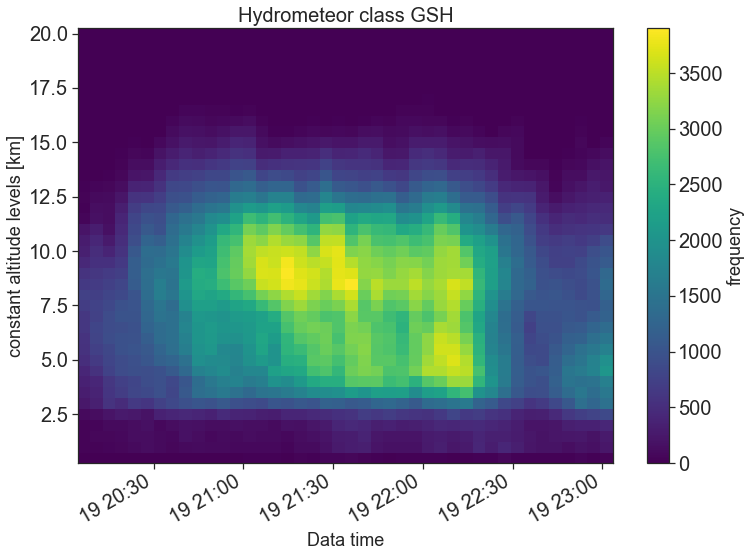

In [37]:
bins = np.arange(1, 20, 1)
hist_pid = histogram(data_zdr["PID"], bins=[bins], dim=["x0", "y0"])

hidcls = 7

fig, ax = plt.subplots()
hist_pid.isel(PID_bin=hidcls).T.plot(cbar_kwargs=dict(label='frequency'))
ax.set_title(f"Hydrometeor class {hid_class[hidcls]}", fontsize=20)

In [291]:
df = hist_pid.sel(z0=slice(4, 11)).to_dataframe()

In [292]:
df = df.reset_index(level=["time", "z0", "PID_bin"])

# need to convert dtype of z0 variable to category to use it as a hue in seaborn plot
df["z0"] = df["z0"].astype("category")
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11340 entries, 0 to 11339
Data columns (total 4 columns):
time             11340 non-null datetime64[ns]
z0               11340 non-null category
PID_bin          11340 non-null float64
histogram_PID    11340 non-null int64
dtypes: category(1), datetime64[ns](1), float64(1), int64(1)
memory usage: 277.7 KB


In [293]:
df

,time,z0,PID_bin,histogram_PID
0,2013-05-19 20:06:44,4.0,1.5,322
1,2013-05-19 20:06:44,4.0,2.5,555
2,2013-05-19 20:06:44,4.0,3.5,1347
3,2013-05-19 20:06:44,4.0,4.5,146
4,2013-05-19 20:06:44,4.0,5.5,6
...,...,...,...,...
11335,2013-05-19 23:01:35,11.0,14.5,0
11336,2013-05-19 23:01:35,11.0,15.5,0
11337,2013-05-19 23:01:35,11.0,16.5,0
11338,2013-05-19 23:01:35,11.0,17.5,3


In [294]:
# create dictionary of ordinal to integer mapping
hid_map = dict(zip(np.arange(1.5, 19.5, 1), hid_class))

# apply using map
df["hid_map"] = df.PID_bin.map(hid_map)
df = df.rename(columns={"histogram_PID": "frequency", "z0": "altitude (km)"})

# df['PID_bin'] = hid

In [295]:
df

,time,altitude (km),PID_bin,frequency,hid_map
0,2013-05-19 20:06:44,4.0,1.5,322,CL
1,2013-05-19 20:06:44,4.0,2.5,555,DRZ
2,2013-05-19 20:06:44,4.0,3.5,1347,LR
3,2013-05-19 20:06:44,4.0,4.5,146,MR
4,2013-05-19 20:06:44,4.0,5.5,6,HR
...,...,...,...,...,...
11335,2013-05-19 23:01:35,11.0,14.5,0,SLD
11336,2013-05-19 23:01:35,11.0,15.5,0,BGS
11337,2013-05-19 23:01:35,11.0,16.5,0,TRIP2
11338,2013-05-19 23:01:35,11.0,17.5,3,GCL


Text(0.5, 1.05, 'frequency count PID')

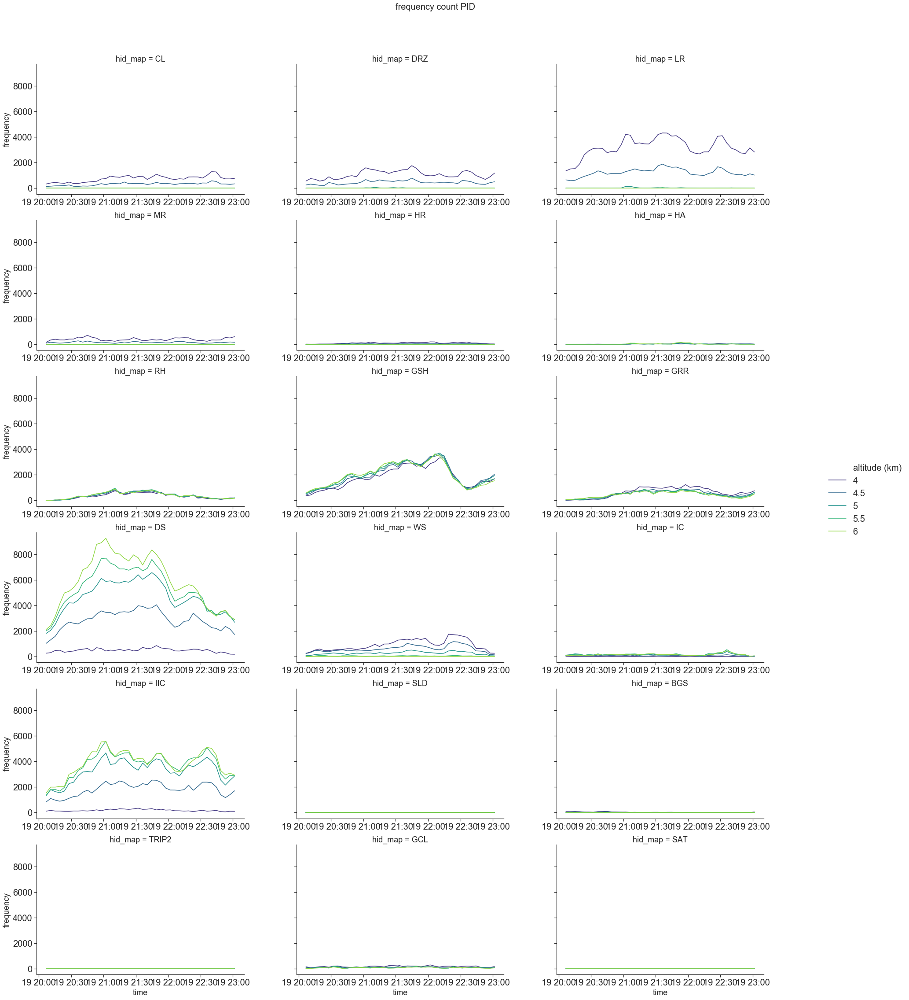

In [296]:
# fig = plt.figure(figsize=(12,12))
g = seaborn.relplot(
    data=df,
    kind="line",
    hue="altitude (km)",
    hue_order=[4, 4.5, 5, 5.5, 6],
    x="time",
    y="frequency",
    palette="viridis",
    col="hid_map",
    col_wrap=3,
    #     style="PID_bin",
    #     style_order=[1.5,2.5,5.5,6.5,7.5,8.5],
    height=5,
    aspect=1,
    facet_kws=dict(sharex=False),
    #     markers=True
)
g.fig.set_figwidth(30)
g.fig.set_figheight(30)
g.fig.suptitle("frequency count PID", y=1.05, fontsize=20)

### Histogram weighted by volume resolution

Text(0.5, 1.0, 'Hydrometeor class DS ')

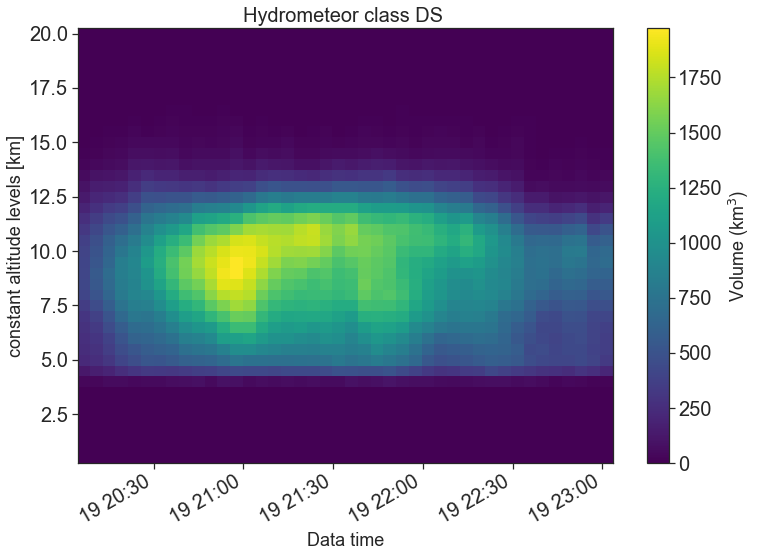

In [274]:
# histogram of number of data points weighted by volume resolution
# Note that depth is a non-uniform axis

# Create a dz variable
dz = np.diff(data_zdr.z0)
dz = np.insert(dz, 0, dz[0])
dz = xr.DataArray(dz, coords={"z0": data_zdr.z0.data}, dims="z0")

dx = data_zdr.x0.diff(dim="x0")
dx = np.insert(dx, 0, dx[0])
dx = xr.DataArray(dx, coords={"x0": data_zdr.x0.data}, dims="x0")

dy = data_zdr.y0.diff(dim="y0")
dy = np.insert(dy, 0, dy[0])
dy = xr.DataArray(dy, coords={"y0": data_zdr.y0.data}, dims="y0")


# weight by volume of grid cell (resolution = 5degree, 1degree=110km)
dVol = dz * dy * dx

# Note: The weights are automatically broadcast to the right size
# hTSw = histogram(ds.smn, ds.tmn, bins=[sbins, tbins], weights=dVol)

bin_level = 10.5

fig, ax = plt.subplots()
hTSw = (
    histogram(data_zdr["PID"], bins=[bins], dim=["x0", "y0"], weights=dVol)
    .sel(PID_bin=bin_level)
    .T.plot(cmap="viridis", cbar_kwargs=dict(label="Volume (km$^{3}$)"))
)
ax.set_title(f"Hydrometeor class {hid_map[bin_level]} ", fontsize=20)
# np.log10(hTSw.T).plot(levels=31, vmin=11.5, vmax=16, cmap='brg')

### Hydrometeor volume time series at each z-level

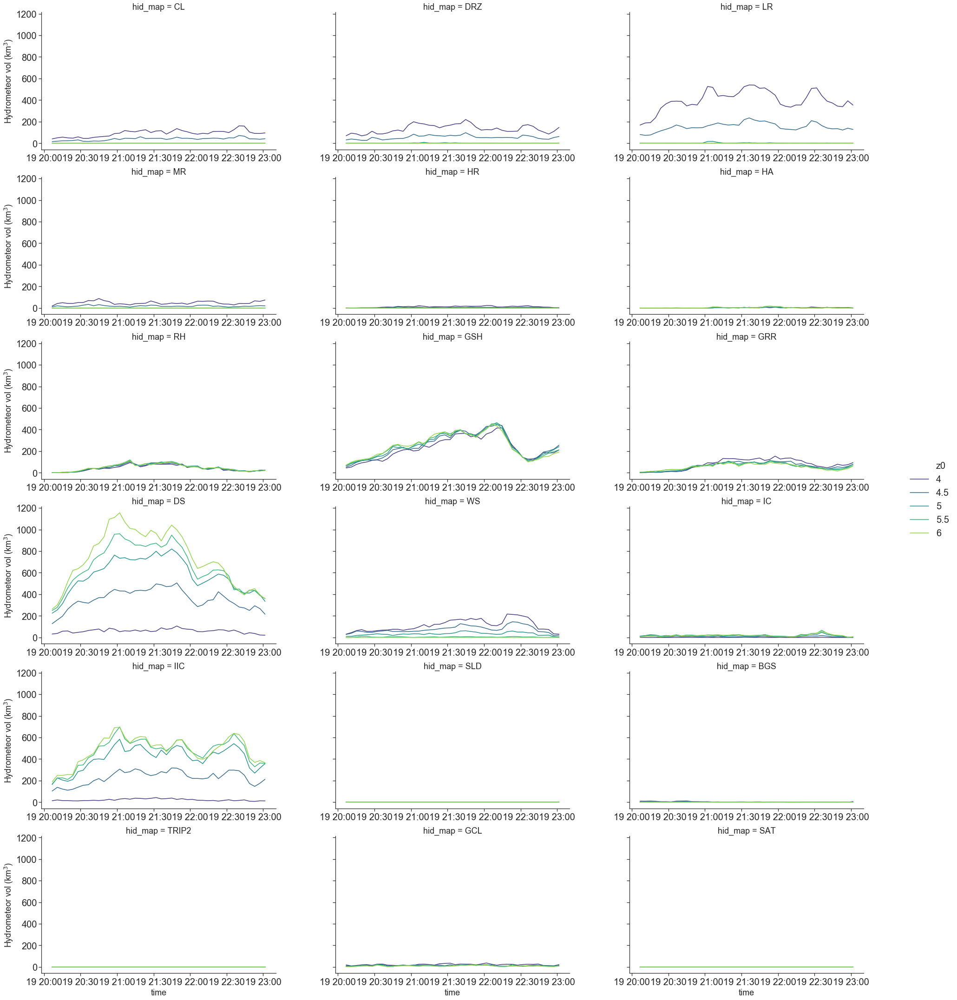

In [252]:
all_hid_vol_df = histogram(
    data_zdr["PID"], bins=[bins], dim=["x0", "y0"], weights=dVol
).to_dataframe()
all_hid_vol_df = all_hid_vol_df.reset_index(level=["time", "z0", "PID_bin"])
all_hid_vol_df["z0"] = all_hid_vol_df["z0"].astype("category")
all_hid_vol_df = all_hid_vol_df.rename(
    columns={"histogram_PID": "Hydrometeor vol (km$^{3}$)"}
)

all_hid_vol_df["hid_map"] = all_hid_vol_df.PID_bin.map(hid_map)

g = seaborn.relplot(
    data=all_hid_vol_df,
    kind="line",
    hue="z0",
    hue_order=[4, 4.5, 5, 5.5, 6],
    x="time",
    y="Hydrometeor vol (km$^{3}$)",
    palette="viridis",
    col="hid_map",
    col_wrap=3,
    #     style="PID_bin",
    #     style_order=[1.5,2.5,5.5,6.5,7.5,8.5],
    height=5,
    aspect=1,
    facet_kws=dict(sharex=False),
    #     markers=True
)
g.fig.set_figwidth(30)
g.fig.set_figheight(30)

### Finally, we plot the vertically integrated hydrometeor volume time series (calculated only within z = 4 to 11 km) 

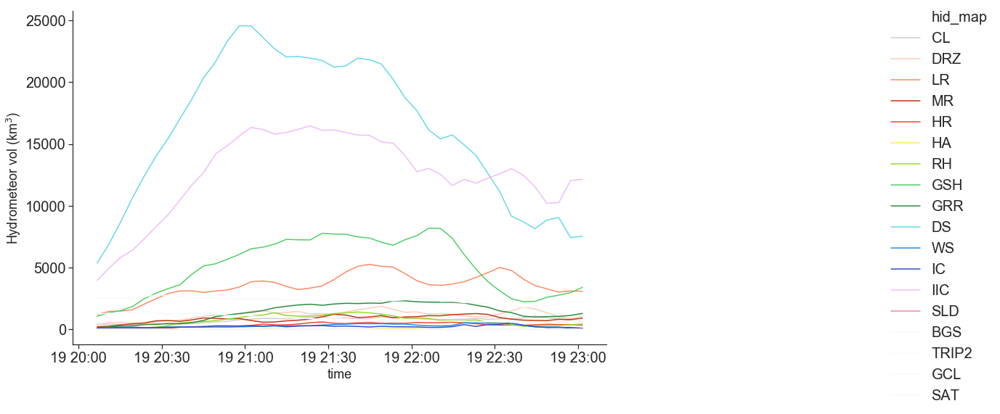

In [265]:
total_vol_df = histogram(
    data_zdr["PID"], bins=[bins], dim=["x0", "y0", "z0"], weights=dVol
).to_dataframe()
total_vol_df = total_vol_df.reset_index(level=["time", "PID_bin"])
total_vol_df = total_vol_df.rename(
    columns={"histogram_PID": "Hydrometeor vol (km$^{3}$)"}
)

total_vol_df["hid_map"] = total_vol_df.PID_bin.map(hid_map)


g = seaborn.relplot(
    data=total_vol_df,
    kind="line",
    hue="hid_map",
    #     hue_order=[4,4.5,5,5.5,6],
    x="time",
    y="Hydrometeor vol (km$^{3}$)",
    palette="ncarpid",
    #     col='hid_map',
    #     style="PID_bin",
    #     style_order=[1.5,2.5,5.5,6.5,7.5,8.5],
    height=5,
    aspect=1,
    #     color_palette = cmapncarpid,
    facet_kws=dict(sharex=False),
    #     markers=True
)
g.fig.set_figwidth(25)
g.fig.set_figheight(8)

In [262]:
total_vol_df

,time,PID_bin,Hydrometeor vol (km$^{3}$),hid_map
0,2013-05-19 20:06:44,1.5,401.875,CL
1,2013-05-19 20:06:44,2.5,391.500,DRZ
2,2013-05-19 20:06:44,3.5,1183.500,LR
3,2013-05-19 20:06:44,4.5,213.375,MR
4,2013-05-19 20:06:44,5.5,43.125,HR
...,...,...,...,...
751,2013-05-19 23:01:35,14.5,0.000,SLD
752,2013-05-19 23:01:35,15.5,625.875,BGS
753,2013-05-19 23:01:35,16.5,0.000,TRIP2
754,2013-05-19 23:01:35,17.5,2187.500,GCL


### Next, we plot the time series of mean ZDR value in all grid cells with a certain PID class
> We use ZDR value in each grid cell with a ~NaN ZDR value as weights for calculating the histogram 

Text(0.5, 1.0, 'Hydrometeor class DS')

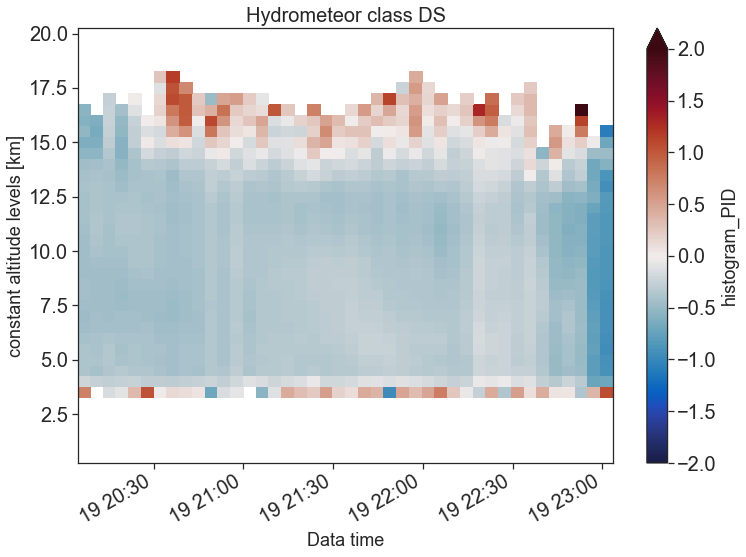

In [158]:
# hTSw = histogram(data['PID'], bins=[bins], dim=['x0','y0'],weights=dVol).isel(PID_bin=7).T.plot(cmap='brg')


hTSzdr = histogram(
    data_zdr["PID"].where(~np.isnan(data_zdr.ZDR)),
    #                    ds.tmn.where(~np.isnan(ds.omn)),
    bins=[bins],
    dim=["x0", "y0"],
    weights=data_zdr.ZDR.where(~np.isnan(data_zdr.ZDR)) * dVol,
) / histogram(
    data_zdr.PID.where(~np.isnan(data_zdr.ZDR)),
    #                           ds.tmn.where(~np.isnan(ds.omn)),
    bins=[bins],
    dim=["x0", "y0"],
    weights=dVol,
)

# (hTSzdr.T).plot(vmin=1, vmax=8)

bin_level = 10.5

fig, ax = plt.subplots()
(hTSzdr.sel(PID_bin=bin_level).T).plot(vmin=-2, vmax=2, cmap=cmo.balance)

ax.set_title(f"Hydrometeor class {hid_map[bin_level]}", fontsize=20)

### 2D Histogram (PID vs dual pol variables)

In [41]:
pidbins = np.arange(1, 19, 1)
zdrbins = np.arange(-2, 8, 0.5)

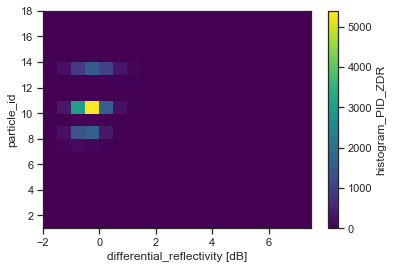

In [50]:
# histogram of number of data points
# histogram of number of data points
hTS = histogram(
    data.PID.isel(time=17, z0=15),
    data.ZDR.isel(time=17, z0=15),
    bins=[pidbins, zdrbins],
)
# np.log10(hTS.T).plot(levels=31)
hTS.plot()

In [84]:
# data1 = data.sum(dim=['x0','y0'])
tt = data[["PID"]].sel(z0=slice(4, 11)).to_dataframe().reset_index(level=["time", "z0"])
# tt["PID"] = tt.PID.astype("category")
tt = tt.drop(labels=["lat0", "lon0"], axis=1)
tt["hue"] = tt["z0"].astype("category")
tt

time    z0   PID   hue
x0    y0                                         
-74.5 0.5   2013-05-19 20:06:44   4.0  15.0   4.0
      0.5   2013-05-19 20:06:44   4.5  12.0   4.5
      0.5   2013-05-19 20:06:44   5.0  12.0   5.0
      0.5   2013-05-19 20:06:44   5.5  13.0   5.5
      0.5   2013-05-19 20:06:44   6.0  13.0   6.0
...                         ...   ...   ...   ...
 45.0 120.0 2013-05-19 23:01:35   9.0   NaN   9.0
      120.0 2013-05-19 23:01:35   9.5   NaN   9.5
      120.0 2013-05-19 23:01:35  10.0   NaN  10.0
      120.0 2013-05-19 23:01:35  10.5   NaN  10.5
      120.0 2013-05-19 23:01:35  11.0   NaN  11.0

[36288000 rows x 4 columns]

In [95]:
# Here we load the segmentation output files and get datetime objects for each time step from radar files

segmented_files = sorted(
    glob.glob("../data/processed/segmented_stacks/zdr/direct_array/*tiff")
)

# rad_files = sorted(glob.glob('path/to/KTLX_data/*V06'))
rad_files = sorted(
    glob.glob("/Users/ms/Desktop/mount/May_19_2013_all_stuff/KTLX_data/*V06")
)
tmpstmps = [
    x.split("/")[-1][4:19] for x in rad_files
]  # access the time stamps from each radar file and convert those into datetime objects
dt_tmpstmps = [datetime.strptime(x, "%Y%m%d_%H%M%S") for x in tmpstmps]

In [79]:
#### fig = plt.figure(figsize=(12,12))

g = seaborn.relplot(
    data=tt,
    kind="line",
    hue="hue",
    hue_order=np.arange(4, 11.5, 0.5),
    x="time",
    y="PID",
    palette="viridis",
    #     style="hue",
    #     style_order=np.arange(4,11.5,0.5),
    height=5,
    aspect=1,
    facet_kws=dict(sharex=False),
    #     markers=True
)
g.fig.set_figwidth(15)
g.fig.set_figheight(8)

#### Now, let's try animating these plots

#### Issues with animation plots are also mentioned.

VERDICT: Better use static plots like in the cell above if needed for journals/presentations purposes (at least for NOW)

> Using hvplot animation

The problem with this animation is that we have no control over colorbar ticks and ticklabels. 

Although we can chain operations in the interactive plotting to create a player for z dimension as well, it turns out that it is computationally expensive and eventually results in crashing of notebook.

Also, the colorbar limits change with each frame. NOT GOOD!

In [174]:
data["PID"] = data["PID"].where(data["PID"] >= 1)

time = pn.widgets.Player(name="time", start=0, end=42, loop_policy="loop", interval=100)
# alt = pn.widgets.Select(name='alt', value=15, options = list(np.arange(0,40,1)))

pid_plot = (
    data.PID.isel(z0=15)
    .interactive.isel(time=time)
    .hvplot(colorbar=True, height=600, width=800, cmap=cmapncarpid,)
)
pid_plot

> Using xarray plot animation

Here, we have better control over ticks but ticklabels are still out of my control

At least, the colorbar limits are constant throughout


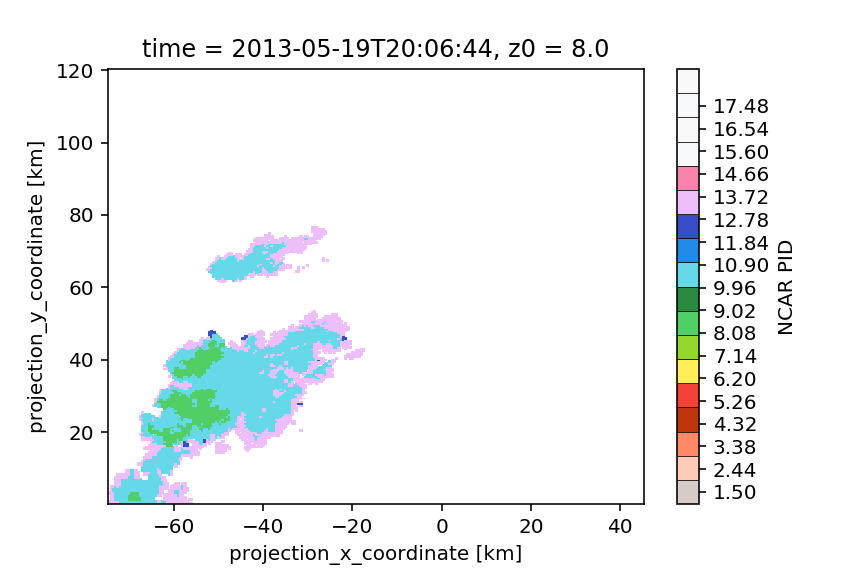
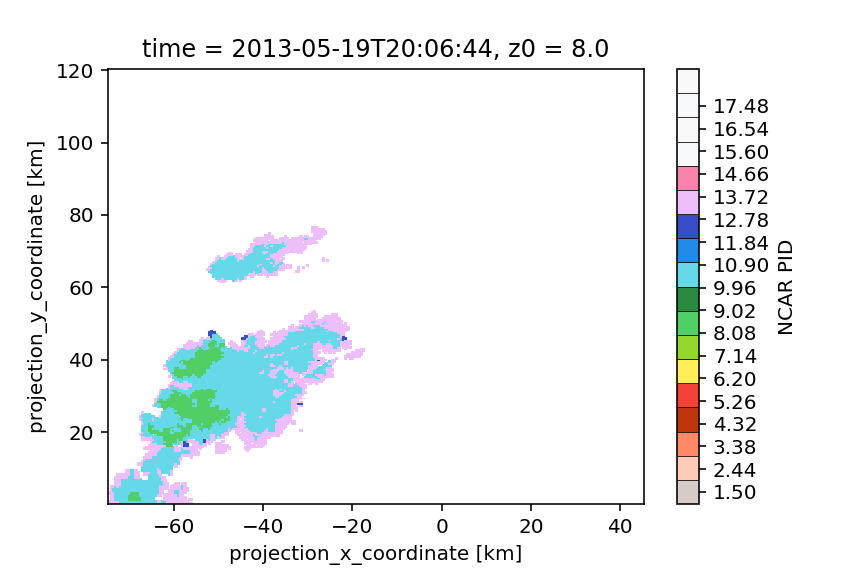
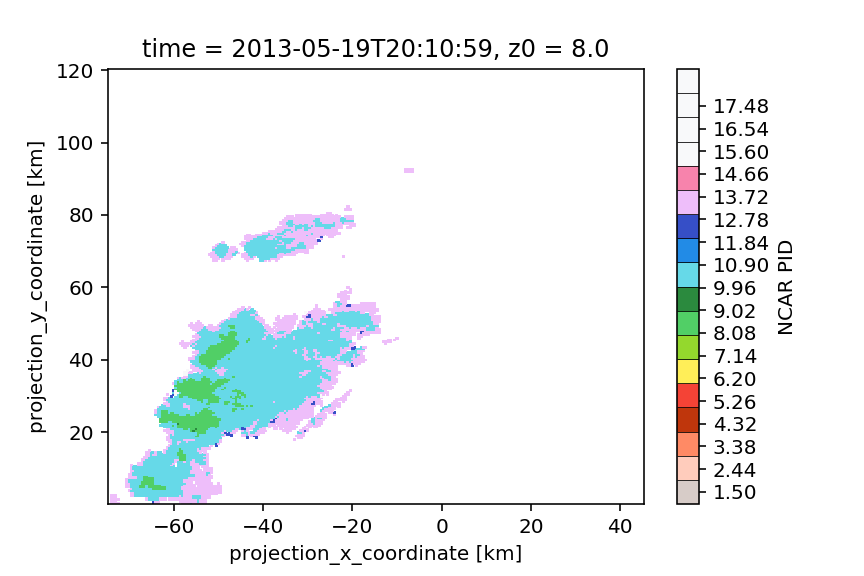
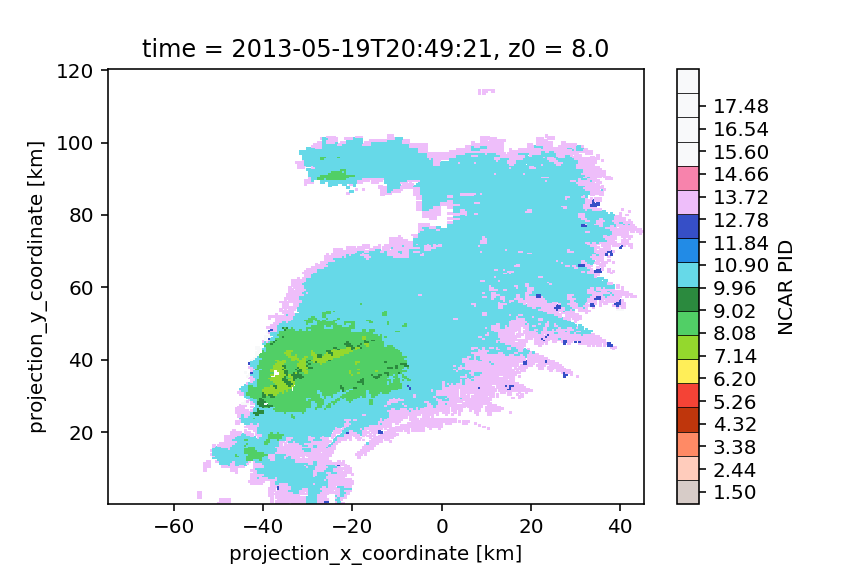
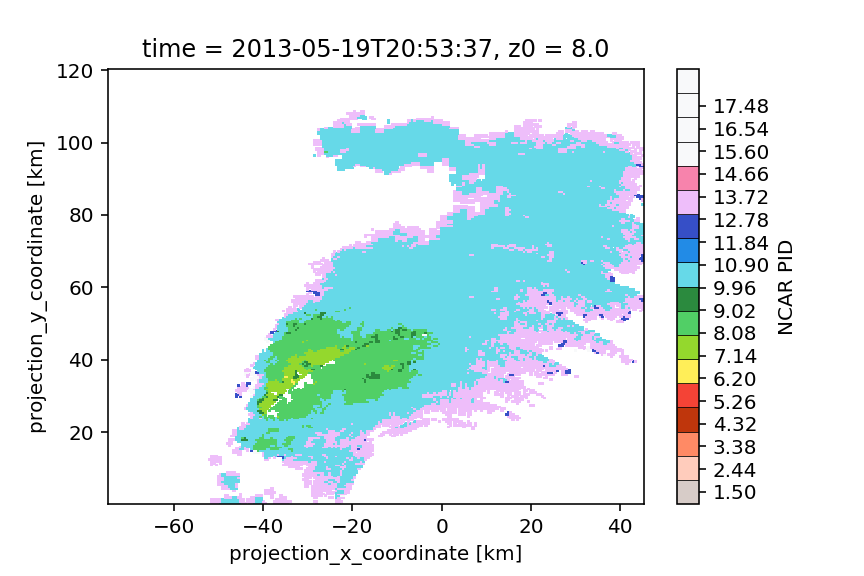
...
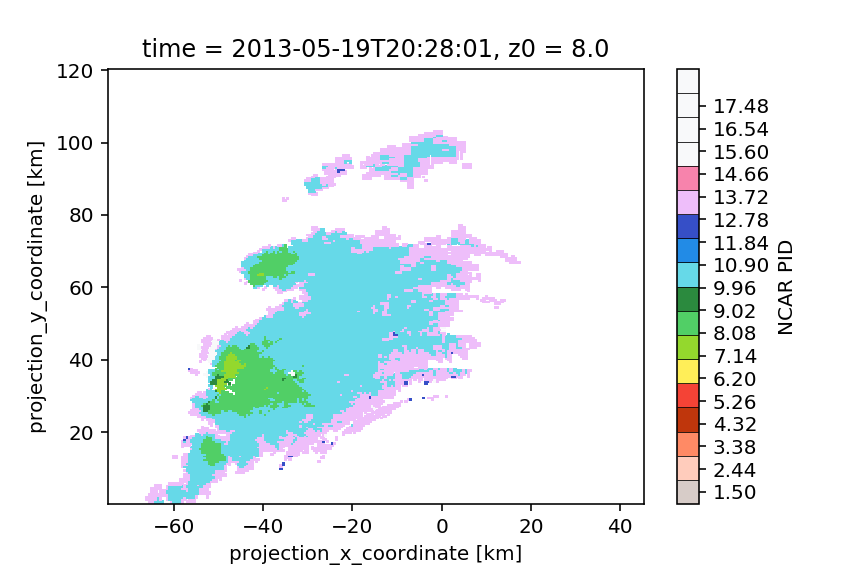
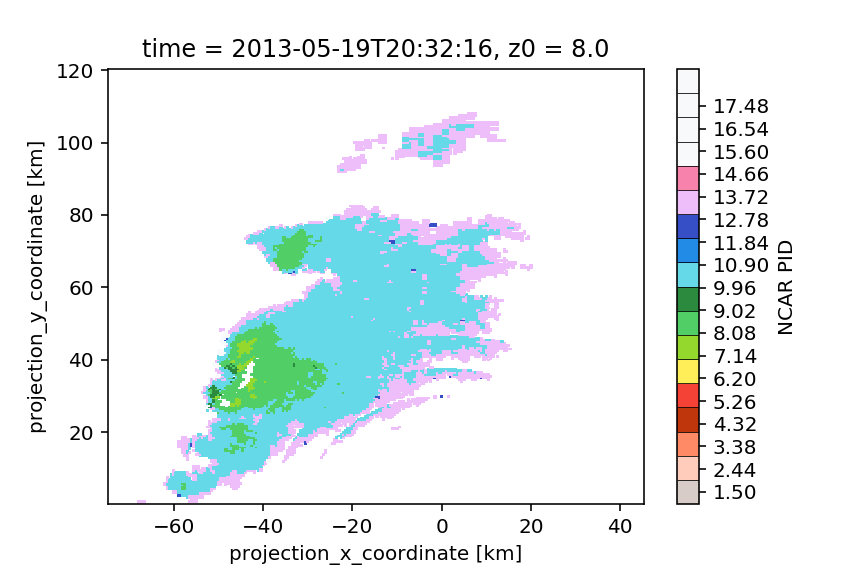
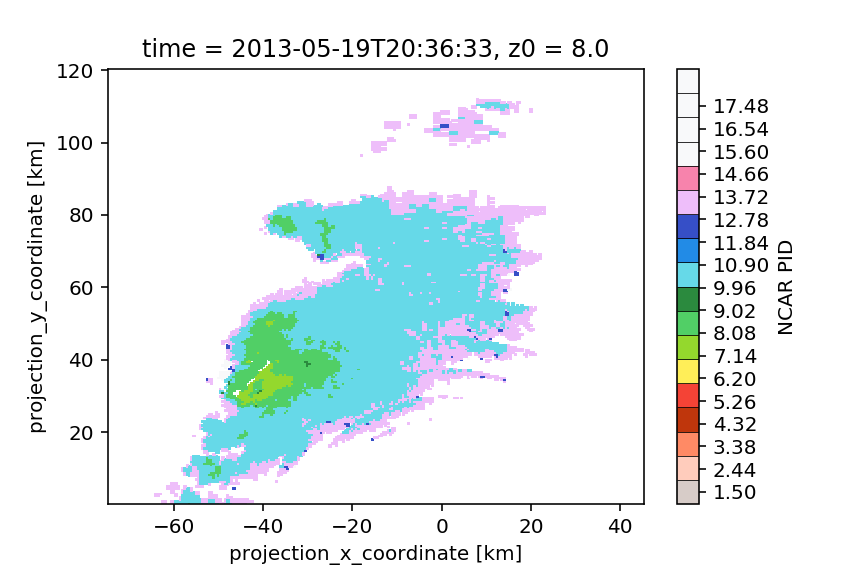
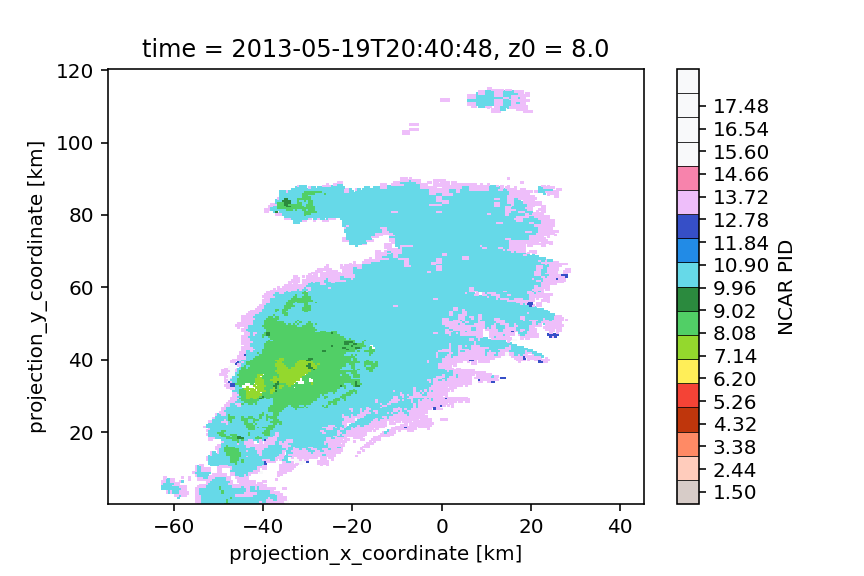
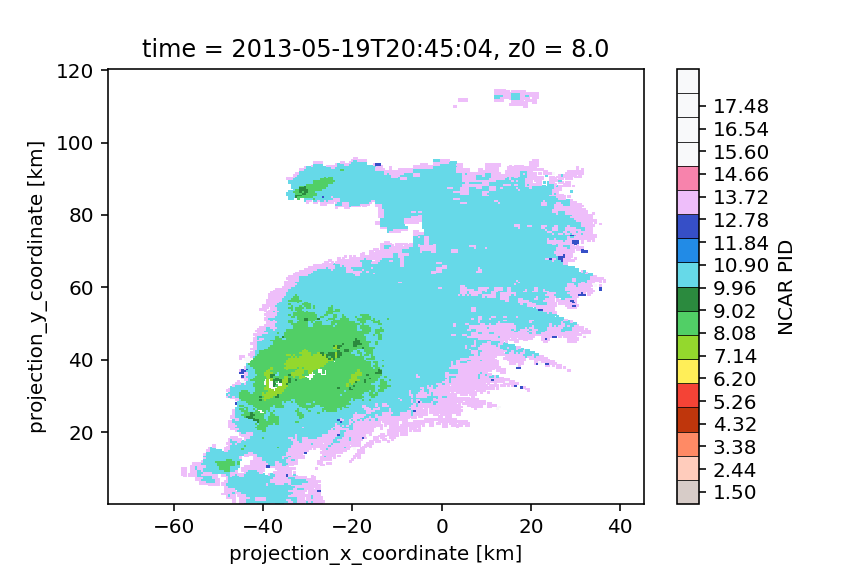

In [178]:
bounds = np.linspace(1, 19, 19)
norm = colors.BoundaryNorm(bounds, cmapncarpid.N)
# colorbar_panel_axes = [0.05, 0.90, .4, .03]


time = pn.widgets.Player(name="time", start=0, end=42, loop_policy="loop", interval=100)
# alt = pn.widgets.Select(name='alt', value=15, options = list(np.arange(0,40,1)))

fig = plt.figure(figsize=(14, 10))
data.PID.isel(z0=15).interactive(loc="bottom").isel(time=time).plot(
    cmap=cmapncarpid,
    norm=norm,
    cbar_kwargs=dict(
        orientation="vertical",
        pad=0.05,
        shrink=1,
        label="NCAR PID",
        ticks=ticker.ticks,
        drawedges=True,
    ),
)